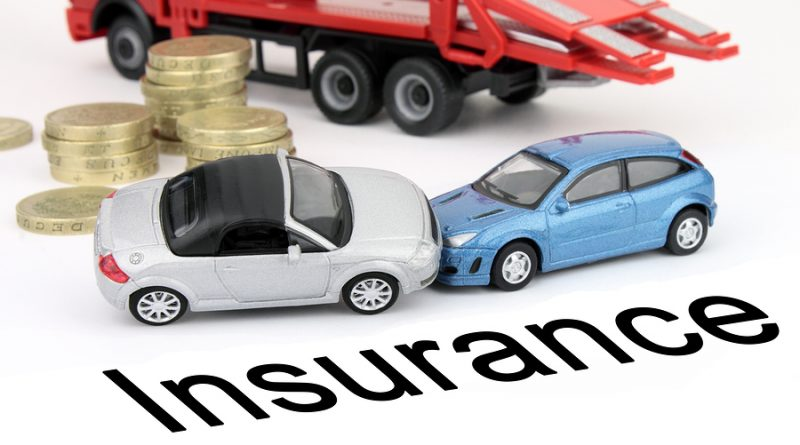

# **Problem Overview**

An insurance company that has provided Health Insurance to its customers now wants to offer Vehicle insurance also. We are required to develop a model that helps predict whether the policyholders (customers) from past year will also be interested in purchasing Vehicle Insurance provided by the company.

The following data is given for building the model:
* id - Unique cust id
* Gender
* Cust age
* Has Driving License - Yes or No
* Region Code
* Previously insured - Yes or No
* Vehicle Age
* Vehicle Damage - Yes or No
* Annual Premium
* Policy Sales Channel
* Vintage - Days of association between company and customer

Target variable:
* Response - Intersted or Not interested

Building a model to predict whether a customer would be interested in Vehicle Insurance is extremely helpful for the company because it can then accordingly plan its communication strategy to reach out to those customers and optimise its business model and revenue.

**In this Notebook, I will**
* Perform EDA
* Do some data cleaning
* Prepare features for feeding to the model
* Evaluate 3 classification algorithms with default parameters first
* Perform Hyperparameter tuning using RandomizedSearchCV
* Generate predictions using the best model
* Make submission

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import plotly.graph_objects as go
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_val_score, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import roc_auc_score, classification_report, roc_curve, confusion_matrix, auc, f1_score
import warnings
warnings.filterwarnings('ignore')

In [2]:
train = pd.read_csv('../input/health-insurance-cross-sell-prediction/train.csv')
test = pd.read_csv('../input/health-insurance-cross-sell-prediction/test.csv')
sample = pd.read_csv('../input/health-insurance-cross-sell-prediction/sample_submission.csv')

In [3]:
train.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [4]:
test.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
0,381110,Male,25,1,11.0,1,< 1 Year,No,35786.0,152.0,53
1,381111,Male,40,1,28.0,0,1-2 Year,Yes,33762.0,7.0,111
2,381112,Male,47,1,28.0,0,1-2 Year,Yes,40050.0,124.0,199
3,381113,Male,24,1,27.0,1,< 1 Year,Yes,37356.0,152.0,187
4,381114,Male,27,1,28.0,1,< 1 Year,No,59097.0,152.0,297


In [5]:
sample.head()

,id,Response
0,381110,0
1,381111,0
2,381112,0
3,381113,0
4,381114,0


In [6]:
print(train.info())
print('*'*50)
print(test.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  object 
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  float64
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  object 
 7   Vehicle_Damage        381109 non-null  object 
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 34.9+ MB
None
**************************************************
<class 'pandas.core.frame.DataFrame'>
Rang

**Exploratory Data Analysis**

Text(0.5, 1.0, 'Log  Distribution of Annual Premium')

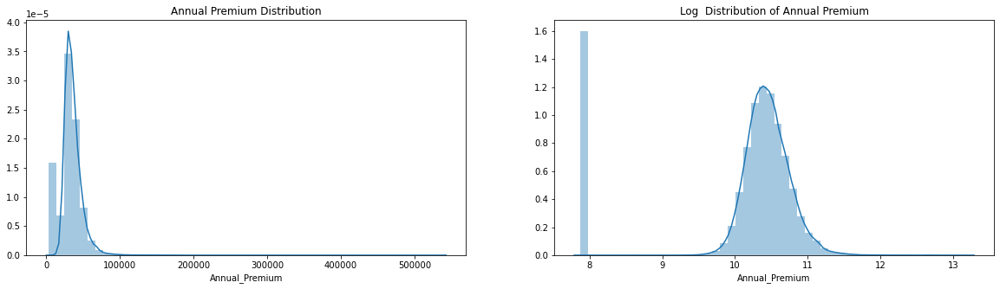

In [7]:
plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
sns.distplot(train['Annual_Premium'], bins=50)
plt.title('Annual Premium Distribution')
plt.subplot(1,2,2)
sns.distplot(np.log1p(train['Annual_Premium']), bins=50)
plt.title('Log  Distribution of Annual Premium')

In [8]:
train['Annual_Premium'].sort_values().tail(10)

281679    472042.0
275442    472042.0
136304    472042.0
172257    489663.0
347413    495106.0
11319     508073.0
54743     540165.0
268332    540165.0
190154    540165.0
144282    540165.0
Name: Annual_Premium, dtype: float64

Most customers are paying annual premium less than Rs.100000. However there are some paying as high as Rs.500000 and above

Text(0.5, 1.0, 'Distribution of Vintage (Days of association between company and customers)')

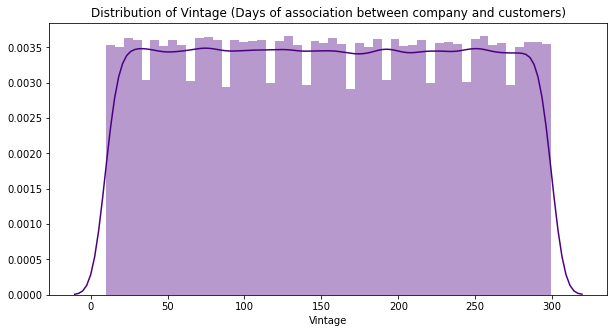

In [9]:
plt.figure(figsize=(10,5))
sns.distplot(train['Vintage'], bins = 50, color='indigo')
plt.title('Distribution of Vintage (Days of association between company and customers)')

Text(0.5, 1.0, 'Customer Age distribution')

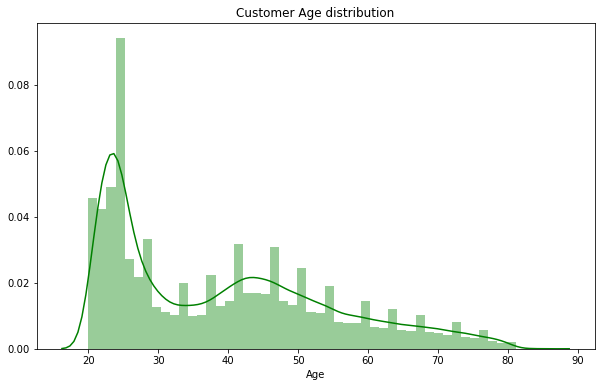

In [10]:
plt.figure(figsize=(10,6))
sns.distplot(train['Age'], bins=50, color='green')
plt.title('Customer Age distribution')

In [11]:
fig = px.pie(train, names='Gender', title='Gender distribution', color = 'Gender', color_discrete_map={'Male':'darkgreen','Female':'yellow'})
fig.show()

In [12]:
fig = px.pie(train, names='Driving_License', title='Driving License distribution')
fig.show()

Almost all customers have Driving License. This is not a very useful feature to learn from. 

In [13]:
fig = px.pie(train, names='Previously_Insured', title='Previously Insured distribution')
fig.show()

Interesting to see that even though 99.8% has DL, only 45.8% has Vehicle insurance. 

In [14]:
fig = px.pie(train, names='Vehicle_Damage', title='Vehicle Damage distribution')
fig.show()

Half the customers have had a damage to their vehicle in the past. The case for vehicle insurance is strong!

In [15]:
fig = px.pie(train, names='Vehicle_Age', title='Vehicle Age distribution')
fig.show()

In [16]:
fig = px.pie(train, names='Region_Code', title='Region Code distribution')
fig.show()

Significant population of customers are from Region Code 28 (~28%). Approx. 50% of total customers are from only 5 regions.

In [17]:
train.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


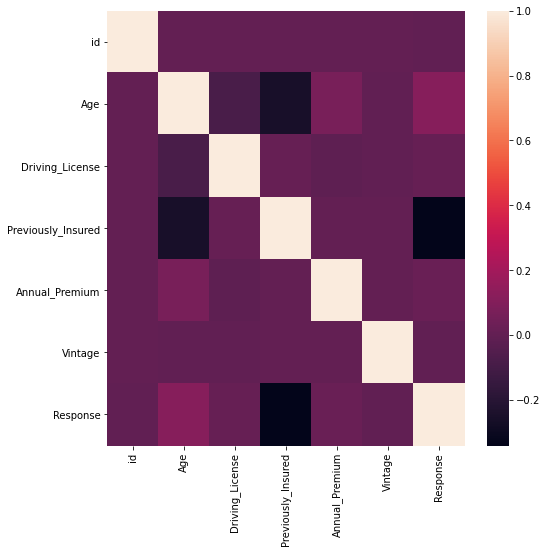

In [18]:
plt.figure(figsize=(8,8))
corr = train.drop(['Region_Code', 'Policy_Sales_Channel'], axis=1).corr()
sns.heatmap(corr)

**Data Cleaning**

In [19]:
columns = ['Gender', 'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage']
for col in columns:
    print(train[col].value_counts(), '\n')

Male      206089
Female    175020
Name: Gender, dtype: int64 

0    206481
1    174628
Name: Previously_Insured, dtype: int64 

1-2 Year     200316
< 1 Year     164786
> 2 Years     16007
Name: Vehicle_Age, dtype: int64 

Yes    192413
No     188696
Name: Vehicle_Damage, dtype: int64 



In [20]:
# One hot encode Gender
train = (train.merge(pd.get_dummies(train.Gender), left_index=True, right_index=True)).drop(['Gender'], axis=1)
test = (test.merge(pd.get_dummies(test.Gender), left_index=True, right_index=True)).drop(['Gender'], axis=1)

# One hot encode Vehicle Age
train = (train.merge(pd.get_dummies(train.Vehicle_Age), left_index=True, right_index=True)).drop(['Vehicle_Age'], axis=1)
test = (test.merge(pd.get_dummies(test.Vehicle_Age), left_index=True, right_index=True)).drop(['Vehicle_Age'], axis=1)

# One hot encode Vehicle Damage
train = (train.merge(pd.get_dummies(train.Vehicle_Damage, prefix = 'veh_damage'),  left_index=True, right_index=True)).drop(['Vehicle_Damage'], axis=1)
test = (test.merge(pd.get_dummies(test.Vehicle_Damage,  prefix = 'veh_damage'), left_index=True, right_index=True)).drop(['Vehicle_Damage'], axis=1)

In [21]:
train.head()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response,Female,Male,1-2 Year,< 1 Year,> 2 Years,veh_damage_No,veh_damage_Yes
0,1,44,1,28.0,0,40454.0,26.0,217,1,0,1,0,0,1,0,1
1,2,76,1,3.0,0,33536.0,26.0,183,0,0,1,1,0,0,1,0
2,3,47,1,28.0,0,38294.0,26.0,27,1,0,1,0,0,1,0,1
3,4,21,1,11.0,1,28619.0,152.0,203,0,0,1,0,1,0,1,0
4,5,29,1,41.0,1,27496.0,152.0,39,0,1,0,0,1,0,1,0


In [22]:
test.head()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Female,Male,1-2 Year,< 1 Year,> 2 Years,veh_damage_No,veh_damage_Yes
0,381110,25,1,11.0,1,35786.0,152.0,53,0,1,0,1,0,1,0
1,381111,40,1,28.0,0,33762.0,7.0,111,0,1,1,0,0,0,1
2,381112,47,1,28.0,0,40050.0,124.0,199,0,1,1,0,0,0,1
3,381113,24,1,27.0,1,37356.0,152.0,187,0,1,0,1,0,0,1
4,381114,27,1,28.0,1,59097.0,152.0,297,0,1,0,1,0,1,0


In [23]:
print(train.shape, test.shape)

(381109, 16) (127037, 15)


In [24]:
train['Policy_Sales_Channel'] = pd.Categorical(train['Policy_Sales_Channel'].astype(int))
test['Policy_Sales_Channel'] = pd.Categorical(test['Policy_Sales_Channel'].astype(int))
train['Region_Code'] = pd.Categorical(train['Region_Code'].astype(int))
test['Region_Code'] = pd.Categorical(test['Region_Code'].astype(int))

In [25]:
# One hot encode Region Code
train = (train.merge(pd.get_dummies(train.Region_Code, prefix = 'reg_code'),  \
                     left_index=True, right_index=True)).drop(['Region_Code'], axis=1)
test = (test.merge(pd.get_dummies(test.Region_Code,  prefix = 'reg_code'), \
                   left_index=True, right_index=True)).drop(['Region_Code'], axis=1)

print(train.info())
print('='*50)
print(test.info())

In [26]:
print(train.shape, test.shape)

(381109, 68) (127037, 67)


In [27]:
train.head()

,id,Age,Driving_License,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response,Female,Male,...,reg_code_43,reg_code_44,reg_code_45,reg_code_46,reg_code_47,reg_code_48,reg_code_49,reg_code_50,reg_code_51,reg_code_52
0,1,44,1,0,40454.0,26,217,1,0,1,...,0,0,0,0,0,0,0,0,0,0
1,2,76,1,0,33536.0,26,183,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,3,47,1,0,38294.0,26,27,1,0,1,...,0,0,0,0,0,0,0,0,0,0
3,4,21,1,1,28619.0,152,203,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,5,29,1,1,27496.0,152,39,0,1,0,...,0,0,0,0,0,0,0,0,0,0


# Split training data into train / valid / test sets

In [28]:
np.random.seed(14321)

X_train, X_valid, X_test = np.split(train.sample(frac=1), [int(.7*len(train)), int(.85*len(train))])

print(f' Data shape: \n X_train shape: {X_train.shape} \n X_valid shape: {X_valid.shape} \n X_test shape: {X_test.shape}')

 Data shape: 
 X_train shape: (266776, 68) 
 X_valid shape: (57166, 68) 
 X_test shape: (57167, 68)


In [29]:
y_train = X_train['Response']
X_train.drop(['id','Response'], axis=1, inplace=True)
y_valid = X_valid['Response']
X_valid.drop(['id','Response'], axis=1, inplace=True)
y_test = X_test['Response']
X_test.drop(['id','Response'], axis=1, inplace=True)

In [30]:
print(f' X_train shape: {X_train.shape} \n y_train shape: {y_train.shape}')

 X_train shape: (266776, 66) 
 y_train shape: (266776,)


In [31]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_valid = scaler.transform(X_valid)
X_test = scaler.transform(X_test)

# LightGBM Classifier

In [32]:
lgb = LGBMClassifier()
lgb.fit(X_train, y_train)
pred_y_train = lgb.predict_proba(X_train)[:, 1]
pred_y_valid = lgb.predict_proba(X_valid)[:, 1]
print(f'Train score: {roc_auc_score(y_train, pred_y_train):.4f}')
print(f'Val score: {roc_auc_score(y_valid, pred_y_valid):.4f}')

Train score: 0.8648
Val score: 0.8596


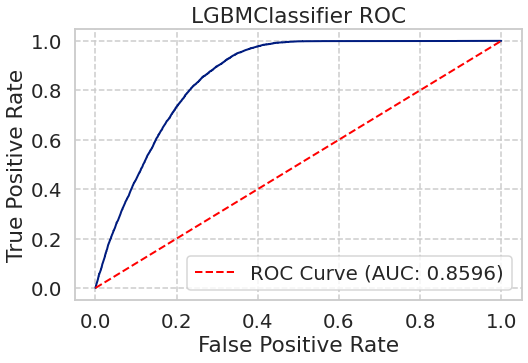

In [33]:
fpr, tpr, _ = roc_curve(y_valid, pred_y_valid)
plt.figure(figsize=(8,5))
sns.set('talk', 'whitegrid', 'dark', font_scale=1.2,rc={"lines.linewidth": 2, 'grid.linestyle': '--'})
plt.plot(fpr, tpr)
plt.plot((0,1), ls = 'dashed', color = 'red', label='ROC Curve (AUC: %.4f)' % auc(fpr, tpr))
plt.title('LGBMClassifier ROC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

# RandomForestClassifier

In [34]:
rfc = RandomForestClassifier(max_depth = 30, min_samples_split = 100, min_samples_leaf = 50)
rfc.fit(X_train, y_train)
pred_y_train = rfc.predict_proba(X_train)[:, 1]
pred_y_valid = rfc.predict_proba(X_valid)[:, 1]
print(f'Train score: {roc_auc_score(y_train, pred_y_train):.4f}')
print(f'Val score: {roc_auc_score(y_valid, pred_y_valid):.4f}')

Train score: 0.8662
Val score: 0.8577


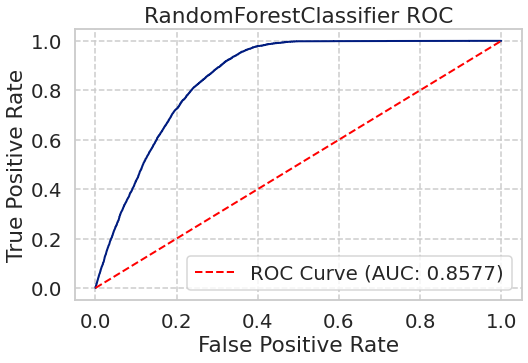

In [35]:
fpr, tpr, _ = roc_curve(y_valid, pred_y_valid)
plt.figure(figsize=(8,5))
sns.set('talk', 'whitegrid', 'dark', font_scale=1.2,rc={"lines.linewidth": 2, 'grid.linestyle': '--'})
plt.plot(fpr, tpr)
plt.plot((0,1), ls = 'dashed', color = 'red', label='ROC Curve (AUC: %.4f)' % auc(fpr, tpr))
plt.title('RandomForestClassifier ROC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

# Cat Boost Classifier

In [36]:
cbc = CatBoostClassifier(iterations=200, learning_rate=0.1, eval_metric = 'AUC', verbose=0)
cbc.fit(X_train, y_train)
pred_y_train = cbc.predict_proba(X_train)[:, 1]
pred_y_valid = cbc.predict_proba(X_valid)[:, 1]
print(f'Train score: {roc_auc_score(y_train, pred_y_train):.4f}')
print(f'Val score: {roc_auc_score(y_valid, pred_y_valid):.4f}')

Train score: 0.8630
Val score: 0.8600


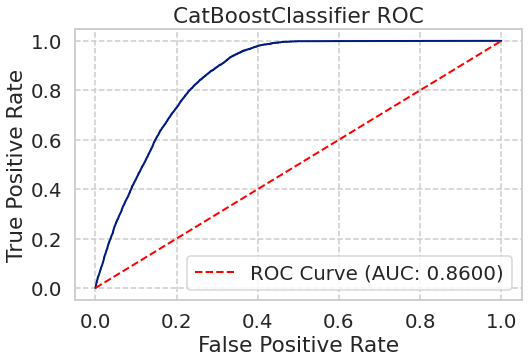

In [37]:
fpr, tpr, _ = roc_curve(y_valid, pred_y_valid)
plt.figure(figsize=(8,5))
sns.set('talk', 'whitegrid', 'dark', font_scale=1.2,rc={"lines.linewidth": 2, 'grid.linestyle': '--'})
plt.plot(fpr, tpr)
plt.plot((0,1), ls = 'dashed', color = 'red', label='ROC Curve (AUC: %.4f)' % auc(fpr, tpr))
plt.title('CatBoostClassifier ROC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

# Results on Test set

In [38]:
print(f'LightGBM score: {roc_auc_score(y_test, lgb.predict_proba(X_test)[:,1]):.4f}')
print(f'Random Forest score: {roc_auc_score(y_test, rfc.predict_proba(X_test)[:,1]):.4f}')
print(f'Cat Boost score: {roc_auc_score(y_test, cbc.predict_proba(X_test)[:,1]):.4f}')

LightGBM score: 0.8591
Random Forest score: 0.8574
Cat Boost score: 0.8598


In [39]:
params = dict(boosting = ['dart'], learning_rate = [0.1], num_iterations = [100])
rs_lgb = RandomizedSearchCV(lgb, param_distributions = params, n_iter = 10, cv = 4, verbose = 0)
rs_lgb.fit(X_train, y_train)
pred_y_train = rs_lgb.predict_proba(X_train)[:, 1]
pred_y_valid = rs_lgb.predict_proba(X_valid)[:, 1]
print(f'Train score: {roc_auc_score(y_train, pred_y_train):.4f}')
print(f'Val score: {roc_auc_score(y_valid, pred_y_valid):.4f}')

Train score: 0.8606
Val score: 0.8593


In [40]:
rs_lgb.best_params_

{'num_iterations': 100, 'learning_rate': 0.1, 'boosting': 'dart'}

In [41]:
params = dict(depth = [8, 12], learning_rate = [0.1, 0.01, 0.2], iterations = [100,200])
rs_cbc = RandomizedSearchCV(cbc, param_distributions = params, n_iter = 10, cv = 4, verbose = 0)
rs_cbc.fit(X_train, y_train)
pred_y_train = rs_cbc.predict_proba(X_train)[:, 1]
pred_y_valid = rs_cbc.predict_proba(X_valid)[:, 1]
print(f'Train score: {roc_auc_score(y_train, pred_y_train):.4f}')
print(f'Val score: {roc_auc_score(y_valid, pred_y_valid):.4f}')

Train score: 0.8695
Val score: 0.8596


In [42]:
rs_cbc.best_params_

{'learning_rate': 0.1, 'iterations': 200, 'depth': 8}

Selecting CatBoost Classifier with default params as it has shown the best performance.

# Submission

In [43]:
test_ids = test['id']
test.drop('id', axis=1, inplace=True)
test = scaler.transform(test)

In [44]:
train_y = train['Response']
train_x = train.drop(['id', 'Response'], axis=1)
train_x = scaler.transform(train_x)

In [45]:
cbc.fit(train_x, train_y)
pred_train = cbc.predict_proba(train_x)[:, 1]
pred_test = cbc.predict_proba(test)[:, 1]
print(f'Train AUC: {roc_auc_score(train_y, pred_train):.4f}')
sub = pd.DataFrame({'id': test_ids, 'Response' : pred_test})

Train AUC: 0.8623
